# NFL Big Data Bowl 2020 - 1st place solution The Zoo

This notebook recreates the NFL Big Data Bowl 2020 winner solution described in [1 

This solution assumes that a rushing play consist of:
- A rusher, whose aim is to run forward as far as possible
- 11 defense players who are trying to stop the rusher
- 10 remaining offense players trying to prevent defenders from blocking or tackling the rusher


This remainder of this notebook is organized as follows. Section 1 describes and contain the code for data processing. Section 2 provides the model structure, and gets into the detail of the CV. Finally, section 3 draws some conclusions and future directions

## Data Processing 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import statsmodels.api as sm

pd.set_option("display.max_columns", 100)

%matplotlib inline

In [2]:
train = pd.read_csv('data/train.csv', dtype={'WindSpeed': 'object'})

In [3]:
def split_play_and_player_cols(df):
    df['IsRusher'] = df['NflId'] == df['NflIdRusher']
    
    play_ids = df["PlayId"].unique()
    
    # We must assume here that the first 22 rows correspond to the same player:
    player_cols = [
        'PlayId', # This is the link between them
        'Season',
        'Team',
        'X',
        'Y',
        'S',
        'A',
        'Dis',
        'Dir',
        'NflId',
        'IsRusher',
        'Yards'
    ]
    df_players = df[player_cols]
    
    play_cols = [
        'PlayId',
        'Season',
        'PossessionTeam',
        'HomeTeamAbbr',
        'VisitorTeamAbbr',
        'PlayDirection', 
        'FieldPosition',
        'YardLine',
        'Yards'
    ]

    df_play = df[play_cols].copy()

    ## Fillna in FieldPosition attribute
    #df['FieldPosition'] = df.groupby(['PlayId'], sort=False)['FieldPosition'].apply(lambda x: x.ffill().bfill())
    
    # Get first 
    df_play = df_play.groupby('PlayId').first().reset_index()

    print('rows/plays in df: ', len(df_play))
    assert df_play.PlayId.nunique() == df.PlayId.nunique(), "Play/player split failed?"  # Boom
    
    return df_play, df_players

In [4]:
play_ids = train["PlayId"].unique()

df_play, df_players = split_play_and_player_cols(train)

rows/plays in df:  31007


#### Team Abbr

We have some problem with the enconding of the teams such as BLT and BAL or ARZ and ARI

In [5]:
def process_team_abbr(df):

    #These are only problems:
    map_abbr = {'ARI': 'ARZ', 'BAL': 'BLT', 'CLE': 'CLV', 'HOU': 'HST'}
    for abb in train['PossessionTeam'].unique():
        map_abbr[abb] = abb

    df['PossessionTeam'] = df['PossessionTeam'].map(map_abbr)
    df['HomeTeamAbbr'] = df['HomeTeamAbbr'].map(map_abbr)
    df['VisitorTeamAbbr'] = df['VisitorTeamAbbr'].map(map_abbr)

    df['HomePossession'] = df['PossessionTeam'] == df['HomeTeamAbbr']
    
    return

process_team_abbr(df_play)

### Play Direction

In [6]:
def process_play_direction(df):
    df['IsPlayLeftToRight'] = df['PlayDirection'].apply(lambda val: True if val.strip() == 'right' else False)
    return

In [7]:
process_play_direction(df_play)

### Yards until End Zone

In [8]:
def process_yard_til_end_zone(df):
    def convert_to_yardline100(row):
        return (100 - row['YardLine']) if (row['PossessionTeam'] == row['FieldPosition']) else row['YardLine']
    df['Yardline100'] = df.apply(convert_to_yardline100, axis=1)
    return

process_yard_til_end_zone(df_play)

## Create Tracking Data Features

In [9]:
df_players = df_players.merge(
    df_play[['PlayId', 'PossessionTeam', 'HomeTeamAbbr', 'PlayDirection', 'Yardline100']], 
    how='left', on='PlayId')

In [1]:
df_players.loc[df_players.Season == 2017].plot.scatter(x='Dis', y='S', title='Season 2017',grid=True)

NameError: name 'df_players' is not defined

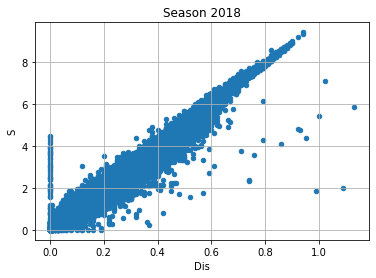

In [11]:
df_players.loc[df_players.Season == 2018].plot.scatter(x='Dis', y='S', title='Season 2018', grid=True)

In [12]:
X = df_players.loc[df_players.Season == 2018]['Dis']
y = df_players.loc[df_players.Season == 2018]['S']
X = sm.add_constant(X)

model = sm.OLS(y, X).fit() 
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      S   R-squared:                       0.979
Model:                            OLS   Adj. R-squared:                  0.979
Method:                 Least Squares   F-statistic:                 1.137e+07
Date:                Fri, 10 Apr 2020   Prob (F-statistic):               0.00
Time:                        18:44:09   Log-Likelihood:                 32141.
No. Observations:              247962   AIC:                        -6.428e+04
Df Residuals:                  247960   BIC:                        -6.426e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0011      0.001      1.182      0.237      -0.001       0.003
Dis            9.9228      0.003   3372.410      0.000       9.917       9.929
==============================================================================
Omnibus:                   145982.942   Durbin-Watson:                   1.918
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         19682710.631
Skew:                          -1.861   Prob(JB):                         0.00
Kurtosis:                      46.488   Cond. No.                         7.44
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [13]:
df_players['S'] = 10*df_players['Dis']

Now, let's adjusted the data to always be from left to right.

In [14]:
def process_tracking_data(df):
    df['HomePossesion'] = df['PossessionTeam'] == df['HomeTeamAbbr']

    df['Dir_rad'] = np.mod(90 - df.Dir, 360) * math.pi/180.0

    df['ToLeft'] = df.PlayDirection == "left"
    df['TeamOnOffense'] = "home"
    df.loc[df.PossessionTeam != df.HomeTeamAbbr, 'TeamOnOffense'] = "away"
    df['IsOnOffense'] = df.Team == df.TeamOnOffense # Is player on offense?
    df['X_std'] = df.X
    df.loc[df.ToLeft, 'X_std'] = 120 - df.loc[df.ToLeft, 'X']
    df['Y_std'] = df.Y
    df.loc[df.ToLeft, 'Y_std'] = 160/3 - df.loc[df.ToLeft, 'Y']
    df['Dir_std'] = df.Dir_rad
    df.loc[df.ToLeft, 'Dir_std'] = np.mod(np.pi + df.loc[df.ToLeft, 'Dir_rad'], 2*np.pi)
   
    #Replace Null in Dir_rad and Orientation_rad
    df.loc[(df.IsOnOffense) & df['Dir_std'].isna(),'Dir_std'] = 0.0
    df.loc[~(df.IsOnOffense) & df['Dir_std'].isna(),'Dir_std'] = np.pi

    # More feature engineering for all:
    df['Sx'] = df['S']*df['Dir_std'].apply(math.cos)
    df['Sy'] = df['S']*df['Dir_std'].apply(math.sin)
    
    # ball carrier position
    rushers = df[df['IsRusher']].copy()
    rushers.set_index('PlayId', inplace=True, drop=True)
    playId_rusher_map = rushers[['X_std', 'Y_std', 'Sx', 'Sy']].to_dict(orient='index')
    rusher_x = df['PlayId'].apply(lambda val: playId_rusher_map[val]['X_std'])
    rusher_y = df['PlayId'].apply(lambda val: playId_rusher_map[val]['Y_std'])
    rusher_Sx = df['PlayId'].apply(lambda val: playId_rusher_map[val]['Sx'])
    rusher_Sy = df['PlayId'].apply(lambda val: playId_rusher_map[val]['Sy'])
    
    # Calculate differences between the rusher and the players:
    df['player_minus_rusher_x'] = rusher_x - df['X_std']
    df['player_minus_rusher_y'] = rusher_y - df['Y_std']

    # Velocity parallel to direction of rusher:
    df['player_minus_rusher_Sx'] = rusher_Sx - df['Sx']
    df['player_minus_rusher_Sy'] = rusher_Sy - df['Sy']

    return

In [15]:
process_tracking_data(df_players)

In [16]:
import matplotlib.patches as patches
def create_football_field(linenumbers=True,
                          endzones=True,
                          highlight_line=False,
                          highlight_line_number=50,
                          highlighted_name='Line of Scrimmage',
                          fifty_is_los=False,
                          figsize=(12*2, 6.33*2)):
    """
    Function that plots the football field for viewing plays.
    Allows for showing or hiding endzones.
    """
    rect = patches.Rectangle((0, 0), 120, 53.3, linewidth=0.1,
                             edgecolor='r', facecolor='darkgreen', zorder=0,  alpha=0.5)

    fig, ax = plt.subplots(1, figsize=figsize)
    ax.add_patch(rect)

    plt.plot([10, 10, 10, 20, 20, 30, 30, 40, 40, 50, 50, 60, 60, 70, 70, 80,
              80, 90, 90, 100, 100, 110, 110, 120, 0, 0, 120, 120],
             [0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3,
              53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 53.3, 0, 0, 53.3],
             color='white')
    if fifty_is_los:
        plt.plot([60, 60], [0, 53.3], color='gold')
        plt.text(62, 50, '<- Player Yardline at Snap', color='gold')
    # Endzones
    if endzones:
        ez1 = patches.Rectangle((0, 0), 10, 53.3,
                                linewidth=0.1,
                                edgecolor='r',
                                facecolor='blue',
                                alpha=0.2,
                                zorder=0)
        ez2 = patches.Rectangle((110, 0), 120, 53.3,
                                linewidth=0.1,
                                edgecolor='r',
                                facecolor='blue',
                                alpha=0.2,
                                zorder=0)
        ax.add_patch(ez1)
        ax.add_patch(ez2)
    plt.xlim(0, 120)
    plt.ylim(-5, 58.3)
    plt.axis('off')
    if linenumbers:
        for x in range(20, 110, 10):
            numb = x
            if x > 50:
                numb = 120 - x
            plt.text(x, 5, str(numb - 10),
                     horizontalalignment='center',
                     fontsize=20,  # fontname='Arial',
                     color='white')
            plt.text(x - 0.95, 53.3 - 5, str(numb - 10),
                     horizontalalignment='center',
                     fontsize=20,  # fontname='Arial',
                     color='white', rotation=180)
    if endzones:
        hash_range = range(11, 110)
    else:
        hash_range = range(1, 120)

    for x in hash_range:
        ax.plot([x, x], [0.4, 0.7], color='white')
        ax.plot([x, x], [53.0, 52.5], color='white')
        ax.plot([x, x], [22.91, 23.57], color='white')
        ax.plot([x, x], [29.73, 30.39], color='white')

    if highlight_line:
        hl = highlight_line_number + 10
        plt.plot([hl, hl], [0, 53.3], color='yellow')
        plt.text(hl + 2, 50, '<- {}'.format(highlighted_name),
                 color='yellow')
    return fig, ax

In [17]:
def get_dx_dy(radian_angle, dist):
    dx = dist * math.cos(radian_angle)
    dy = dist * math.sin(radian_angle)
    return dx, dy

def show_play_std(play_id, train=df_players):
    df = train[train.PlayId == play_id]
    fig, ax = create_football_field()
    ax.scatter(df.X_std, df.Y_std, cmap='rainbow', c=~(df.IsOnOffense), s=100)
    rusher_row = df[df.IsRusher]
    ax.scatter(rusher_row.X_std, rusher_row.Y_std, color='black')
    yards_covered = rusher_row["Yards"].values[0]

    for (x, y, Dir, S) in zip(df.X_std, df.Y_std, df.Dir_std, df.S):       
        dx, dy = get_dx_dy(Dir, S)
        ax.arrow(x, y, dx, dy, length_includes_head=False, width=0.2, color='black', alpha=0.5)
 
    left = 'left' if df.ToLeft.sum() > 0 else 'right'
    plt.title(f'Play # {play_id} moving to {left}, yard distance is {yards_covered}', fontsize=20)
    plt.legend()
    plt.show()

No handles with labels found to put in legend.


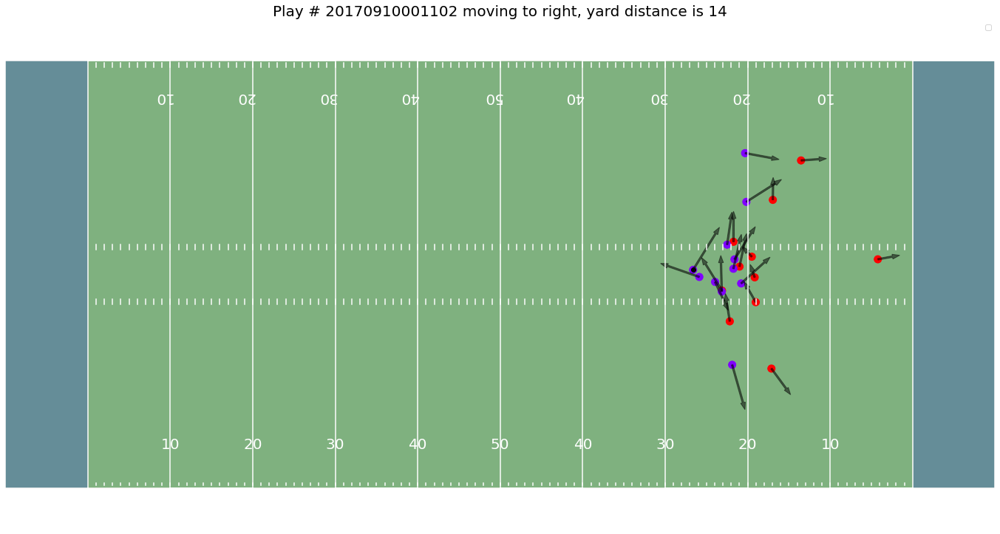

No handles with labels found to put in legend.


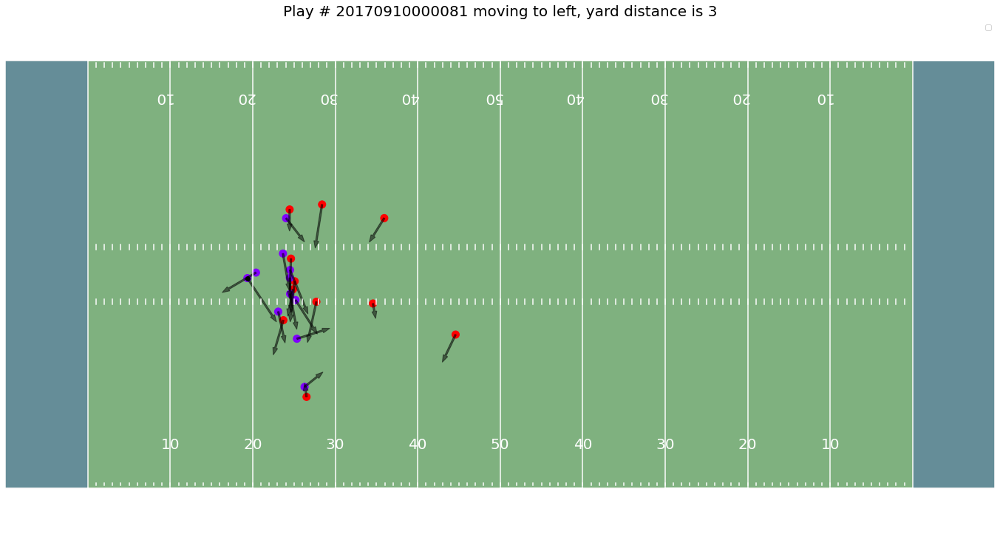

In [18]:
for play_id in [20170910001102, 20170910000081]: 
    show_play_std(play_id)

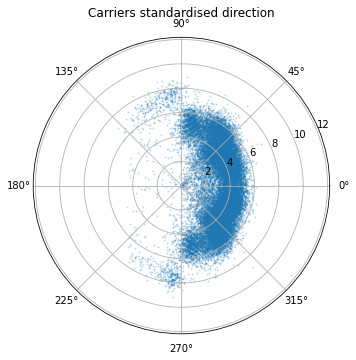

In [19]:
plt.figure(figsize=(12, 12))

ax = plt.subplot(221, projection='polar')
df = df_players[df_players.IsOnOffense & df_players.IsRusher]
ax.set_title('Carriers standardised direction')
ax.scatter(df.Dir_std, df.S, s=1, alpha=0.2)

In [20]:
tracking_level_features = [
    'PlayId',
    'IsOnOffense',
    'X_std',
    'Y_std',
    'Sx',
    'Sy',
    'player_minus_rusher_x',
    'player_minus_rusher_y',
    'player_minus_rusher_Sx',
    'player_minus_rusher_Sy',
    'IsRusher'
]

df_all_feats = df_players[tracking_level_features]

print('Any null values: ', df_all_feats.isnull().sum().sum())

Any null values:  0


There are 5 vector features which were important (so 10 numeric features if you count projections on X and Y axis), we added a few more, but they have insignificant contribution. The vectors are relative locations and speeds, so to derive them we used only ‘X’, ‘Y’, ‘S’ and ‘Dir’ variables from data. Nothing else is really important, not even wind direction or birthday of a player ;-)

<img src="images/input.png" style="width:380px;height:150px;">

In [21]:
grouped = df_all_feats.groupby('PlayId')
train_x = np.zeros([len(grouped.size()),11,10,10])
i = 0
for name, group in grouped:
    [[rusher_x, rusher_y, rusher_Sx, rusher_Sy]] = group.loc[group.IsRusher==1,['X_std', 'Y_std','Sx','Sy']].values

    offense_ids = group[group.IsOnOffense & ~group.IsRusher].index
    defense_ids = group[~group.IsOnOffense].index
    defense_level = []
    for j, defense_id in enumerate(defense_ids):
        [def_x, def_y, def_Sx, def_Sy] = group.loc[defense_id,['X_std', 'Y_std','Sx','Sy']].values
        [def_rusher_x, def_rusher_y] = group.loc[defense_id,['player_minus_rusher_x', 'player_minus_rusher_y']].values
        [def_rusher_Sx, def_rusher_Sy] =  group.loc[defense_id,['player_minus_rusher_Sx', 'player_minus_rusher_Sy']].values
        offense_level = []
        for k, offense_id in enumerate(offense_ids):
            [off_x, off_y, off_Sx, off_Sy] = group.loc[offense_id,['X_std', 'Y_std','Sx','Sy']].values
            train_x[i,j,k,:] = [off_Sx - def_Sx, off_Sy - def_Sy, off_x - def_x, off_y - def_y, 
                                def_rusher_Sx, def_rusher_Sy, def_rusher_x, def_rusher_y, def_Sx, def_Sy]
    i+=1

np.save('data/train_x.npy', train_x)

In [28]:
# Transform Y into indexed-classes:
train_y = df_play[['PlayId', 'Yards']].copy()

train_y['YardIndex'] = train_y['Yards'].apply(lambda val: val + 99)

min_idx_y = 71
max_idx_y = 150

train_y['YardIndexClipped'] = train_y['YardIndex'].apply(
    lambda val: min_idx_y if val < min_idx_y else max_idx_y if val > max_idx_y else val)

print('max yardIndex: ', train_y.YardIndex.max())
print('max yardIndexClipped: ', train_y.YardIndexClipped.max())
print('min yardIndex: ', train_y.YardIndex.min())
print('min yardIndexClipped: ', train_y.YardIndexClipped.min())

train_y.to_pickle('data/train_y.pkl')

max yardIndex:  198
max yardIndexClipped:  150
min yardIndex:  84
min yardIndexClipped:  84


In [29]:
df_season = df_play[['PlayId', 'Season']].copy()
df_season.to_pickle('data/df_season.pkl')

## Train ConvNet

In [2]:
train_x = np.load('data/train_x.npy') 
#train_y_values = np.load('data/train_y_values.npy')
train_y = pd.read_pickle('data/train_y.pkl') 
df_season = pd.read_pickle('data/df_season.pkl')

num_classes_y = 199
min_idx_y = 71
max_idx_y = 150
#num_classes_y = max_idx_y - min_idx_y + 1

In [3]:
from tensorflow.keras.models import Model

from tensorflow.keras.layers import (
    Conv1D, Conv2D, MaxPooling1D, MaxPooling2D, AvgPool1D, AvgPool2D,
    Input, Activation, BatchNormalization, Dense, Add, Lambda, Dropout, LayerNormalization)

from tensorflow.keras.optimizers import Adam
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import Callback

import tensorflow as tf 
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold

def crps(y_true, y_pred):
    loss = K.mean(K.sum((K.cumsum(y_pred, axis = 1) - K.cumsum(y_true, axis=1))**2, axis=1))/199
    return loss

In [4]:
class Metric(Callback):
    def __init__(self, data):
        self.data = data

    def on_epoch_end(self, batch, logs=None):
        X_train, y_train = self.data[0][0], self.data[0][1]
        y_pred = self.model.predict(X_train)
        y_true = np.clip(np.cumsum(y_train, axis=1), 0, 1)
        y_pred = np.clip(np.cumsum(y_pred, axis=1), 0, 1)
        tr_s = ((y_true - y_pred) ** 2).sum(axis=1).sum(axis=0) / (199 * X_train.shape[0])
        logs['tr_CRPS'] = tr_s

        X_valid, y_valid = self.data[1][0], self.data[1][1]

        y_pred = self.model.predict(X_valid)
        y_true = np.clip(np.cumsum(y_valid, axis=1), 0, 1)
        y_pred = np.clip(np.cumsum(y_pred, axis=1), 0, 1)
        val_s = ((y_true - y_pred) ** 2).sum(axis=1).sum(axis=0) / (199 * X_valid.shape[0])
        logs['val_CRPS'] = val_s
        print('\nTraining CRPS: {}, Val CRPS: {}\n'.format(tr_s, val_s))

In [5]:
from sklearn.preprocessing import StandardScaler

models = []
kf = KFold(n_splits=5, shuffle=True, random_state=42)
score = []

for i, (tdx, vdx) in enumerate(kf.split(train_x, train_y)):
    print(f'Fold : {i}')
    X_train, X_val = train_x[tdx], train_x[vdx],
    #y_train, y_val = train_y_values[tdx], train_y_values[vdx]
    y_train, y_val = train_y.iloc[tdx]['YardIndexClipped'].values, train_y.iloc[vdx]['YardIndexClipped'].values
    season_val = df_season.iloc[vdx]['Season'].values

    y_train_values = np.zeros((len(y_train), num_classes_y), np.int32)
    for irow, row in enumerate(y_train):
        y_train_values[(irow, row)] = 1
        
    y_val_values = np.zeros((len(y_val), num_classes_y), np.int32)
    for irow, row in enumerate(y_val):
        y_val_values[(irow, row)] = 1

    val_idx = np.where(season_val==2018)

    X_val = X_val[val_idx]
    y_val_values = y_val_values[val_idx]

    y_train_values = y_train_values.astype('float32')
    y_val_values = y_val_values.astype('float32')

    inputdense_players = Input(shape=(11,10,10), name = "playersfeatures_input")
    X = Conv2D(128, kernel_size=(1,1), strides=(1,1), activation=None)(inputdense_players)
    X = Activation('relu')(X)
    X = Conv2D(160, kernel_size=(1,1), strides=(1,1), activation=None)(X)
    X = Activation('relu')(X)
    X = Conv2D(128, kernel_size=(1,1), strides=(1,1), activation=None)(X)
    X = Activation('relu')(X)
    
    Xmax = MaxPooling2D(pool_size=(1,10))(X)
    Xmax = Lambda(lambda x1 : x1*0.3)(Xmax)

    Xavg = AvgPool2D(pool_size=(1,10))(X)
    Xavg = Lambda(lambda x1 : x1*0.7)(Xavg)

    X = Add()([Xmax, Xavg])
    X = Lambda(lambda y : K.squeeze(y,2))(X)
    X = BatchNormalization()(X)
    X = Conv1D(160, kernel_size=1, strides=1, activation=None)(X)
    X = Activation('relu')(X)
    X = BatchNormalization()(X)
    X = Conv1D(96, kernel_size=1, strides=1, activation=None)(X)
    X = Activation('relu')(X)
    X = BatchNormalization()(X)
    X = Conv1D(96, kernel_size=1, strides=1, activation=None)(X)
    X = Activation('relu')(X)
    X = BatchNormalization()(X)
    
    Xmax = MaxPooling1D(pool_size=11)(X)
    Xmax = Lambda(lambda x1 : x1*0.3)(Xmax)

    Xavg = AvgPool1D(pool_size=11)(X)
    Xavg = Lambda(lambda x1 : x1*0.7)(Xavg)

    X = Add()([Xmax, Xavg])
    X = Lambda(lambda y : K.squeeze(y,1))(X)
    X = Dense(96)(X)
    X = Activation('relu')(X)
    X = LayerNormalization()(X)

    X = Dense(256, activation="relu")(X)
    X = Activation('relu')(X)
    X = LayerNormalization()(X)
    X = Dropout(0.3)(X)

    outsoft = Dense(num_classes_y, activation='softmax', name = "output")(X)

    model = Model(inputs = [inputdense_players], outputs = outsoft)

    decay = (0.001/0.0005 - 1)/50 #Time-based decay formula
    model.compile(loss=crps,
                  optimizer=Adam(learning_rate=0.002, decay=decay))
    
    model.fit(X_train,
              y_train_values, 
              epochs=50,
              batch_size=64,
              verbose=1,
              validation_data=(X_val, y_val_values))

    val_crps_score = model.evaluate(X_val, y_val_values, verbose=0)
    score.append(val_crps_score)

    models.append(model)
    
print(np.mean(score))

Fold : 0
Train on 24805 samples, validate on 2218 samples
Epoch 1/50
24805/24805 [==============================] - 13s 513us/sample - loss: 0.0143 - val_loss: 0.0136
Epoch 2/50
24805/24805 [==============================] - 12s 466us/sample - loss: 0.0131 - val_loss: 0.0134
Epoch 3/50
24805/24805 [==============================] - 12s 467us/sample - loss: 0.0128 - val_loss: 0.0131
Epoch 4/50
24805/24805 [==============================] - 12s 474us/sample - loss: 0.0126 - val_loss: 0.0129
Epoch 5/50
24805/24805 [==============================] - 12s 467us/sample - loss: 0.0125 - val_loss: 0.0129
Epoch 6/50
24805/24805 [==============================] - 12s 499us/sample - loss: 0.0124 - val_loss: 0.0128
Epoch 7/50
24805/24805 [==============================] - 12s 480us/sample - loss: 0.0123 - val_loss: 0.0129
Epoch 8/50
24805/24805 [==============================] - 12s 464us/sample - loss: 0.0123 - val_loss: 0.0129
Epoch 9/50
24805/24805 [==============================] - 12s 502us/sa

KeyboardInterrupt: 

In [ ]:
model.count_params()